# Discovering fake videos different magnitudes of fakeness

This notebook analyzes the per face frame similarity scores collected during face difference mask generation.
Similarity score is a metric that quantifies the structural similarity between a face crop from fake video and a corresponding face crop from real video. Unaltered faces should have a high similarity score close to 1.0 but not necessarily one because of the artifacts coming from video compression.

## Goals

**1. Rule out real face frames from fake videos and label them as real.**

Some of the two-person videos have possibly a real unaltered face included but we have no certainty which one or if either.

**2. Discover different types of fake faces and assign fake-type classes.**

Some fakes are better than others and thus, harder to detect. If we train classifier to detect with fakes with an abundace of really bad fakes, the model likely becomes good at judging only these but not so good at spotting the hard ones. Giving fakeness-magnitude based labels to fake frames, allows us to sample hard examples differently and combat this bias.

In [15]:
import os
import glob
import torch
import cv2
from PIL import Image
import numpy as np
import pandas as pd
from pathlib import Path
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm as tqdm
import json
import seaborn as sns
with open("../user_config.json") as config:
    path_dict = json.load(config)['data_paths']
    video_path = path_dict['video_path']
    large_face_path = path_dict['large_faces']

#large_face_path = '../../DeepFake/large_faces_2/'

In [2]:
df_diff = pd.read_csv('../data/frame_diff.csv')
df_diff.head()

,index,original,first_person_similarities,second_person_similarities
0,gmuagvvcen.mp4,xyioxposka.mp4,[0.90662205 0.91454544 0.90863778 0.90787758 0...,NaN
1,nlbejgudfx.mp4,acguxjvmju.mp4,[0.87670463 0.87884638 0.88174117 0.88052886 0...,NaN
2,smptxlklxc.mp4,NaN,[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. ...,NaN
3,xmodyeeaxr.mp4,ptpwappdyx.mp4,[0.96768544 0.9703409 0.96584001 0.96793804 0...,NaN
4,hvxrsfgvyi.mp4,qelncdmypn.mp4,[0.93245532 0.93241838 0.93094194 0.93391931 0...,[0.96927007 0.9687523 0.97080696 0.96831491 0...


Read only fake faces

In [3]:
df_diff = df_diff[~df_diff['original'].isnull()]
df_diff.head()

,index,original,first_person_similarities,second_person_similarities
0,gmuagvvcen.mp4,xyioxposka.mp4,[0.90662205 0.91454544 0.90863778 0.90787758 0...,NaN
1,nlbejgudfx.mp4,acguxjvmju.mp4,[0.87670463 0.87884638 0.88174117 0.88052886 0...,NaN
3,xmodyeeaxr.mp4,ptpwappdyx.mp4,[0.96768544 0.9703409 0.96584001 0.96793804 0...,NaN
4,hvxrsfgvyi.mp4,qelncdmypn.mp4,[0.93245532 0.93241838 0.93094194 0.93391931 0...,[0.96927007 0.9687523 0.97080696 0.96831491 0...
5,duhilxsfwa.mp4,pfbdxvexft.mp4,[0.89427626 0.90188644 0.89832524 0.9075775 0...,NaN


Take average video differences for clustering

In [4]:
def str2array(text):
    if type(text)==float:
        return None
    values = text.replace('\n','').replace('[','').replace(']','').split(' ')
    values = [val for val in values if val != ""]
    return np.array(values, np.float32)

def arrayMean(arr):
    if arr is None:
        return None
    return np.mean(arr)

def arrayMin(arr):
    if arr is None:
        return None
    return min(arr)

def arrayMax(arr):
    if arr is None:
        return None
    return max(arr)

def arrayStd(arr):
    if arr is None:
        return None
    return np.std(arr)

In [5]:
# first person
df_diff['avg_first_person_similarity'] = [arrayMean(str2array(df_diff.loc[i,'first_person_similarities'])) for i in df_diff.index.values]
df_diff['min_first_person_similarity'] = [arrayMin(str2array(df_diff.loc[i,'first_person_similarities'])) for i in df_diff.index.values]
df_diff['max_first_person_similarity'] = [arrayMax(str2array(df_diff.loc[i,'first_person_similarities'])) for i in df_diff.index.values]
df_diff['std_first_person_similarity'] = [arrayStd(str2array(df_diff.loc[i,'first_person_similarities'])) for i in df_diff.index.values]

# second person
df_diff['avg_second_person_similarity'] = [arrayMean(str2array(df_diff.loc[i,'second_person_similarities'])) for i in df_diff.index.values]
df_diff['min_second_person_similarity'] = [arrayMin(str2array(df_diff.loc[i,'second_person_similarities'])) for i in df_diff.index.values]
df_diff['max_second_person_similarity'] = [arrayMax(str2array(df_diff.loc[i,'second_person_similarities'])) for i in df_diff.index.values]
df_diff['std_second_person_similarity'] = [arrayStd(str2array(df_diff.loc[i,'second_person_similarities'])) for i in df_diff.index.values]

In [7]:
df_diff.head()

,index,original,first_person_similarities,second_person_similarities,avg_first_person_similarity,min_first_person_similarity,max_first_person_similarity,std_first_person_similarity,avg_second_person_similarity,min_second_person_similarity,max_second_person_similarity,std_second_person_similarity
0,gmuagvvcen.mp4,xyioxposka.mp4,[0.90662205 0.91454544 0.90863778 0.90787758 0...,NaN,0.909021,0.896542,0.918606,0.005678,NaN,NaN,NaN,NaN
1,nlbejgudfx.mp4,acguxjvmju.mp4,[0.87670463 0.87884638 0.88174117 0.88052886 0...,NaN,0.879146,0.869597,0.883283,0.003270,NaN,NaN,NaN,NaN
3,xmodyeeaxr.mp4,ptpwappdyx.mp4,[0.96768544 0.9703409 0.96584001 0.96793804 0...,NaN,0.963502,0.957045,0.970341,0.003687,NaN,NaN,NaN,NaN
4,hvxrsfgvyi.mp4,qelncdmypn.mp4,[0.93245532 0.93241838 0.93094194 0.93391931 0...,[0.96927007 0.9687523 0.97080696 0.96831491 0...,0.933331,0.919174,0.946812,0.006300,0.972921,0.968315,0.980188,0.004474
5,duhilxsfwa.mp4,pfbdxvexft.mp4,[0.89427626 0.90188644 0.89832524 0.9075775 0...,NaN,0.899369,0.885830,0.909901,0.005999,NaN,NaN,NaN,NaN


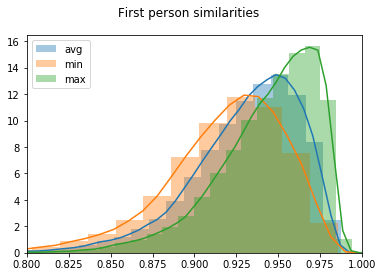

In [9]:
sns.distplot(df_diff['avg_first_person_similarity'].dropna(), label='avg')
sns.distplot(df_diff['min_first_person_similarity'].dropna(), label='min')
sns.distplot(df_diff['max_first_person_similarity'].dropna(), label='max')
plt.xlim(0.8,1)
plt.xlabel('')
plt.suptitle('First person similarities')
plt.legend()

(0, 0.05)

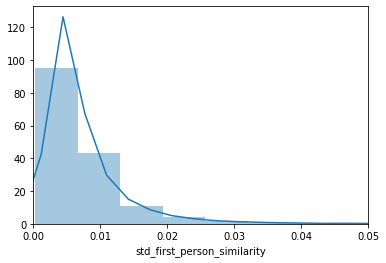

In [10]:
sns.distplot(df_diff['std_first_person_similarity'].dropna(), label='std')
plt.xlim(0,0.05)

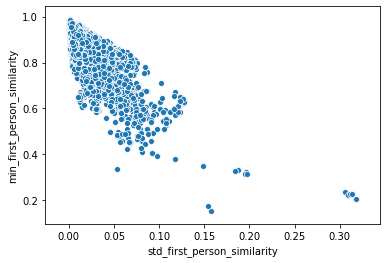

In [11]:
sns.scatterplot(x='std_first_person_similarity',
                y='min_first_person_similarity',
                data=df_diff)

### Second person
We'll assume that in two person fake videos, the other person is at least sometimes real. Thus, the similarity scores of second persons should be higher. Due to video compression artefacts, the similarities don't reach 1.0 even if the person is real.

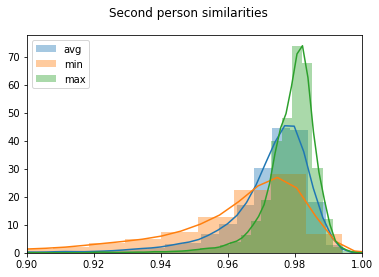

In [12]:
sns.distplot(df_diff['avg_second_person_similarity'].dropna(), label='avg')
sns.distplot(df_diff['min_second_person_similarity'].dropna(), label='min')
sns.distplot(df_diff['max_second_person_similarity'].dropna(), label='max')
#sns.distplot(df_diff['std_second_person_similarity'], label='std')
plt.xlabel('')
plt.suptitle('Second person similarities')
plt.xlim(0.9,1)
plt.legend()

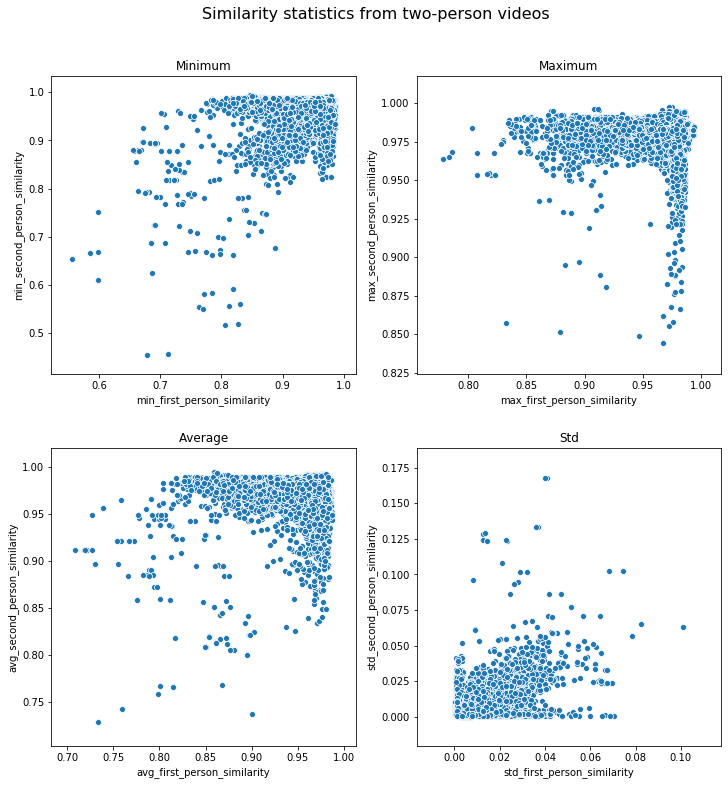

In [13]:
f,ax=plt.subplots(2,2,figsize=(12,12))
sns.scatterplot(x='min_first_person_similarity',y='min_second_person_similarity',data=df_diff, ax=ax[0,0])
ax[0,0].set_title('Minimum')
sns.scatterplot(x='max_first_person_similarity',y='max_second_person_similarity',data=df_diff, ax=ax[0,1])
ax[0,1].set_title('Maximum')
sns.scatterplot(x='avg_first_person_similarity',y='avg_second_person_similarity',data=df_diff, ax=ax[1,0])
ax[1,0].set_title('Average')
sns.scatterplot(x='std_first_person_similarity',y='std_second_person_similarity',data=df_diff, ax=ax[1,1])
ax[1,1].set_title('Std')
plt.suptitle('Similarity statistics from two-person videos',fontsize=16)
plt.subplots_adjust(top=0.9,hspace=0.25)

If we make the assumption, that on at least some of the two-person fake videos, one person is real. Then, when comparing the two-person similarities, real one is close to 1.0 and the fake one lower. We can see such pattern on the above plots and the minimum similarity comparison is perhaps the most reliable measure because fake frames can occasionally cause a significant drop in similarity but not necessarily in every frame.

## Visualize difference masks vs. similarity scores

In [31]:
def getDiffMask(video_fn, person_index=0, frame_index=0):
    imagename = video_fn.replace('.mp4','_') + str(person_index) + '_' + str(frame_index) + '.jpg'
    return cv2.imread(os.path.join(large_face_path,imagename))

def getFaceImg(video_fn, person_index=0, frame_index=0):
    imagename = video_fn.replace('.mp4','_') + str(person_index) + '_' + str(frame_index) + '.png'
    return cv2.cvtColor(cv2.imread(os.path.join(large_face_path,imagename)),cv2.COLOR_BGR2RGB)

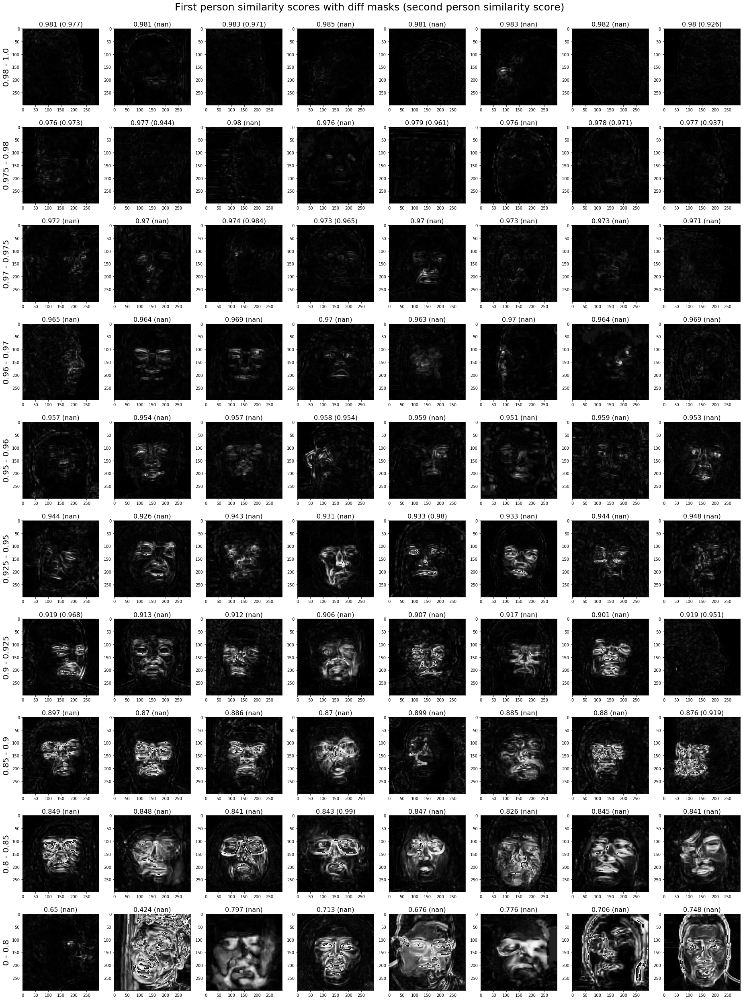

In [42]:
n_samples = 8
similarity_ranges = [[0.98,1.0],
                     [0.975,0.98],
                     [0.97,0.975],
                     [0.96,0.97],
                     [0.95,0.96],
                     [0.925,0.95],
                     [0.9,0.925],
                     [0.85,0.9],
                     [0.8,0.85],
                     [0,0.8]]
plot_img_size=4
f, ax = plt.subplots(len(similarity_ranges),n_samples, figsize=(n_samples*plot_img_size,
                                                                len(similarity_ranges)*plot_img_size))

for row,(min_similarity,max_similarity) in enumerate(similarity_ranges):
    # get samples from this range
    df_samples = df_diff[df_diff['min_first_person_similarity'] > min_similarity]
    df_samples = df_samples[df_samples['min_first_person_similarity'] <= max_similarity]
    ax[row,0].set_ylabel('{0} - {1}'.format(min_similarity,max_similarity),fontsize=20)
    for col in range(min(n_samples,len(df_samples))):
        score = df_samples.iloc[col]['min_first_person_similarity']
        second_person_score = df_samples.iloc[col]['min_second_person_similarity']
        video_fn = df_samples.iloc[col]['index']
        score_arr = arrayMean(str2array(df_samples.iloc[col]['first_person_similarities']))
        img = getDiffMask(video_fn, frame_index=np.argmin(score_arr))
        ax[row,col].imshow(img)
        ax[row,col].set_title('{0:.3} ({1:.3})'.format(score, second_person_score),fontsize=16)
f.suptitle('First person similarity scores with diff masks (second person similarity score)',fontsize=25)
plt.subplots_adjust(top=0.96)

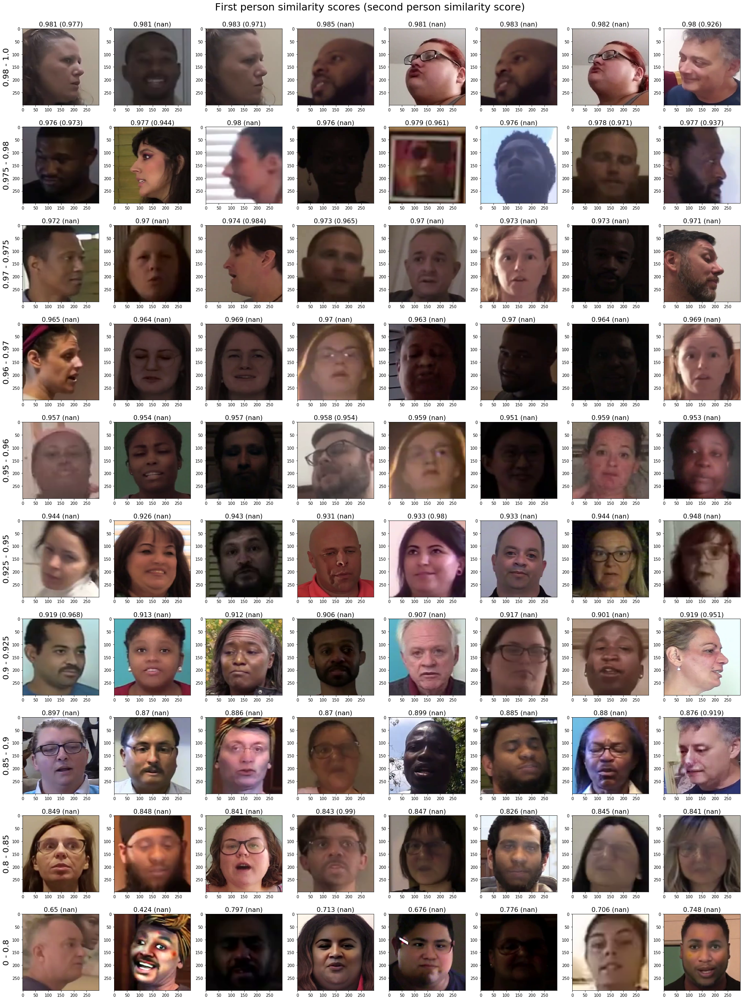

In [43]:
f, ax = plt.subplots(len(similarity_ranges),n_samples, figsize=(n_samples*plot_img_size,
                                                                len(similarity_ranges)*plot_img_size))

for row,(min_similarity,max_similarity) in enumerate(similarity_ranges):
    # get samples from this range
    df_samples = df_diff[df_diff['min_first_person_similarity'] > min_similarity]
    df_samples = df_samples[df_samples['min_first_person_similarity'] <= max_similarity]
    ax[row,0].set_ylabel('{0} - {1}'.format(min_similarity,max_similarity),fontsize=20)
    for col in range(min(n_samples,len(df_samples))):
        score = df_samples.iloc[col]['min_first_person_similarity']
        second_person_score = df_samples.iloc[col]['min_second_person_similarity']
        video_fn = df_samples.iloc[col]['index']
        score_arr = arrayMean(str2array(df_samples.iloc[col]['first_person_similarities']))
        img = getFaceImg(video_fn, frame_index=np.argmin(score_arr))
        ax[row,col].imshow(img)
        ax[row,col].set_title('{0:.3} ({1:.3})'.format(score, second_person_score),fontsize=16)
f.suptitle('First person similarity scores (second person similarity score)',fontsize=25)
plt.subplots_adjust(top=0.96)

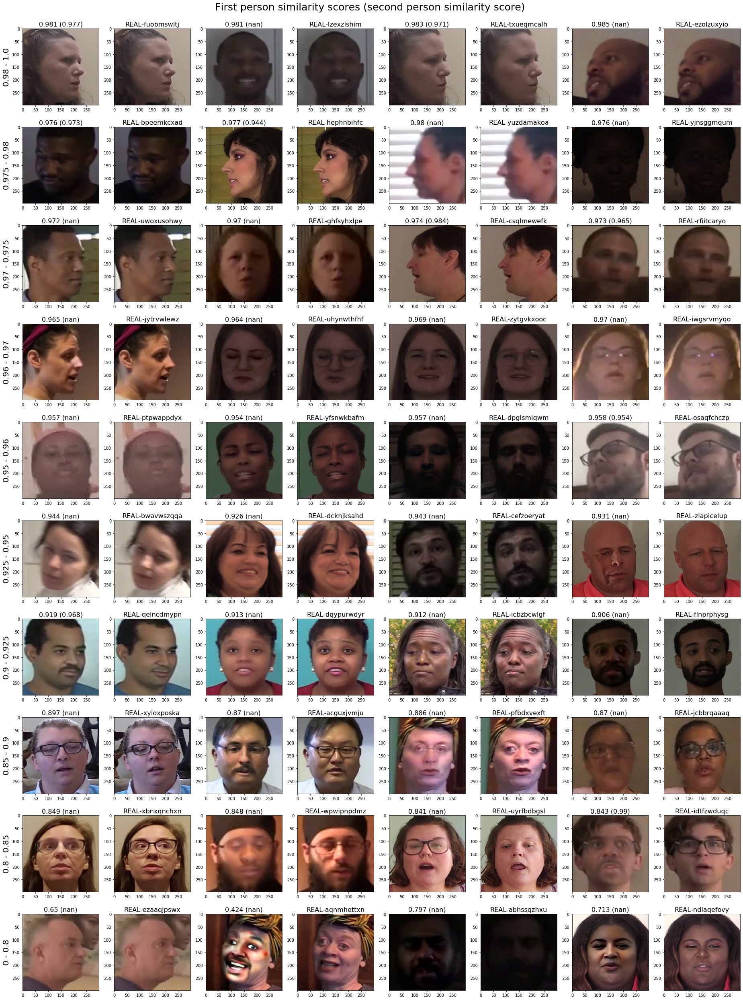

In [47]:
n_samples = 4
f, ax = plt.subplots(len(similarity_ranges),n_samples*2, figsize=(n_samples*2*plot_img_size,
                                                                len(similarity_ranges)*plot_img_size))

for row,(min_similarity,max_similarity) in enumerate(similarity_ranges):
    # get samples from this range
    df_samples = df_diff[df_diff['min_first_person_similarity'] > min_similarity]
    df_samples = df_samples[df_samples['min_first_person_similarity'] <= max_similarity]
    ax[row,0].set_ylabel('{0} - {1}'.format(min_similarity,max_similarity),fontsize=20)
    for col in range(min(n_samples,len(df_samples))):
        score = df_samples.iloc[col]['min_first_person_similarity']
        second_person_score = df_samples.iloc[col]['min_second_person_similarity']
        video_fn = df_samples.iloc[col]['index']
        score_arr = arrayMean(str2array(df_samples.iloc[col]['first_person_similarities']))
        img = getFaceImg(video_fn, frame_index=np.argmin(score_arr))
        ax[row,col*2].imshow(img)
        ax[row,col*2].set_title('{0:.3} ({1:.3})'.format(score, second_person_score),fontsize=16)
        
        real_video = df_samples.iloc[col]['original']
        realImg = getFaceImg(real_video, frame_index=np.argmin(score_arr))
        ax[row,col*2+1].imshow(realImg)
        ax[row,col*2+1].set_title('REAL-' + real_video.replace('.mp4',''), fontsize=16)
f.suptitle('First person similarity scores (second person similarity score)',fontsize=25)
plt.subplots_adjust(top=0.96)

### REAL vs. FAKE frame threshold (Goal 1)

Based on the above visualizations, `similarity_score = 0.975` seems like a decent threshold for separating fake and real frames.

Text(0.5, 0.98, 'Real person > 0.975')

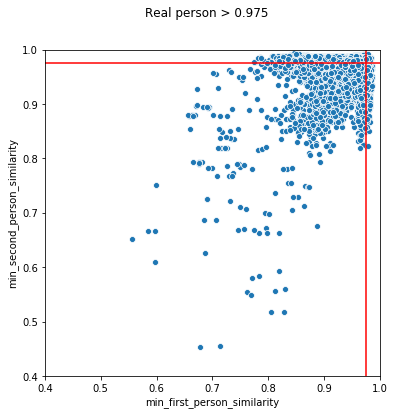

In [54]:
import matplotlib.lines as mlines

SIMILARITY_TH = 0.975

f,ax = plt.subplots(1,1,figsize=(6,6))
sns.scatterplot(x='min_first_person_similarity',y='min_second_person_similarity',data=df_diff, ax=ax)
l = mlines.Line2D([0,1], [SIMILARITY_TH,SIMILARITY_TH], color='r')
l2 = mlines.Line2D([SIMILARITY_TH,SIMILARITY_TH],[0,1],color='r')
ax.add_line(l)
ax.add_line(l2)
ax.set_xlim(0.4,1)
ax.set_ylim(0.4,1)
f.suptitle('Real person > {0}'.format(SIMILARITY_TH))

This threshold doesn't catch all reals but it's more important to keep the fakes labeled as fakes. 

------------------------------------

## Fake type clustering

In [55]:
def getStats(arr):
    return np.array([arrayMin(arr),arrayStd(arr)])

In [57]:
data = [getStats(str2array(df_diff.loc[i,'first_person_similarities'])) for i in df_diff.index.values]

In [58]:
data = [d for d in data if d[0] is not None]

In [61]:
data = np.array(data)

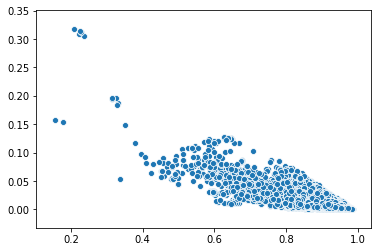

In [62]:
sns.scatterplot(data[:,0],data[:,1])

## K-means

In [66]:
from sklearn.cluster import KMeans
from itertools import cycle

In [91]:
kmeans = KMeans(n_clusters=5, random_state=0).fit(data)
labels = kmeans.labels_

Class th 0.9386451244354248
Class th 0.8597524762153625
Class th 0.15580059587955475
Class th 0.7386626601219177
Class th 0.9051480889320374


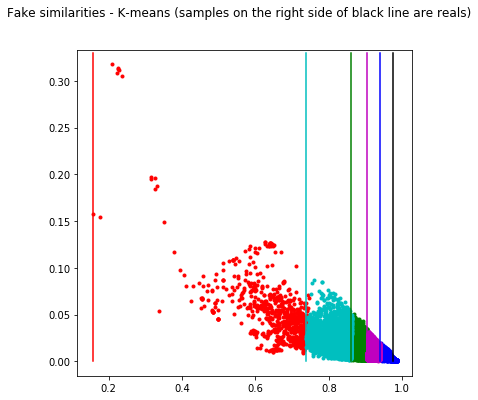

In [92]:
labels_unique = np.unique(labels)
n_clusters_ = len(labels_unique)
f,ax = plt.subplots(1,1,figsize=(6,6))

colors = cycle('bgrcmykbgrcmykbgrcmykbgrcmyk')
for k, col in zip(range(n_clusters_), colors):
    my_members = labels == k
    ax.plot(data[my_members, 0], data[my_members, 1], col + '.')
l = mlines.Line2D([SIMILARITY_TH,SIMILARITY_TH],[0,0.33],color='black')
ax.add_line(l)
class_ths = []
class_lines = []
for k, label in enumerate(labels_unique):
    min_val = 1
    for (l,val) in zip(labels, data[:,0]):
        min_val = min(min_val,val) if l==label else min_val
    class_ths.append(min_val)
    class_lines.append(mlines.Line2D([min_val,min_val],[0,0.33],color='bgrcmykbgrcmykbgrcmykbgrcmyk'[k]))


for k, line in enumerate(class_lines):
    ax.add_line(line)
    print('Class th {0}'.format(class_ths[k]))
    
plt.suptitle('Fake similarities - K-means (samples on the right side of black line are reals)')
plt.show()

## Visualize the new classes

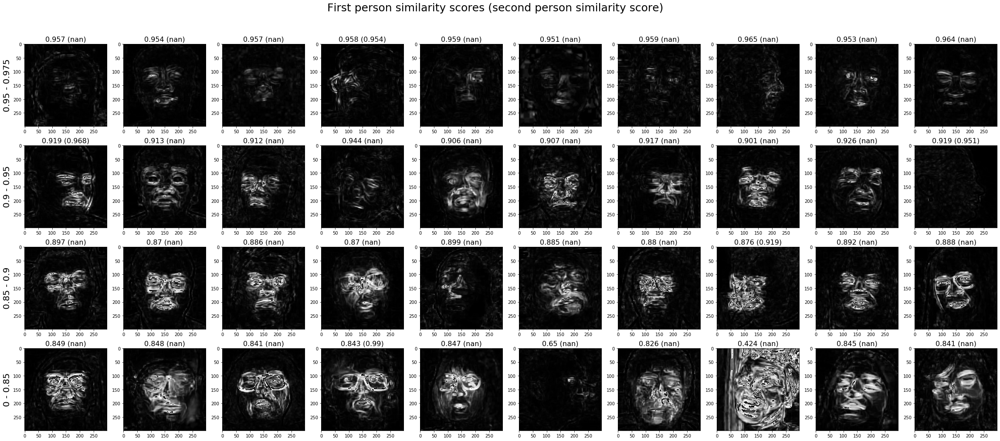

In [94]:
n_samples = 10
TH_1 = 0.95
TH_2 = 0.90
TH_3 = 0.85

similarity_ranges = [[TH_1,SIMILARITY_TH],
                     [TH_2,TH_1],
                     [TH_3,TH_2],
                     [0,TH_3]]

f, ax = plt.subplots(len(similarity_ranges),n_samples, figsize=(n_samples*plot_img_size,
                                                                len(similarity_ranges)*plot_img_size))

for row,(min_similarity,max_similarity) in enumerate(similarity_ranges):
    # get samples from this range
    df_samples = df_diff[df_diff['min_first_person_similarity'] > min_similarity]
    df_samples = df_samples[df_samples['min_first_person_similarity'] <= max_similarity]
    ax[row,0].set_ylabel('{0} - {1}'.format(min_similarity,max_similarity),fontsize=20)
    for col in range(min(n_samples,len(df_samples))):
        score = df_samples.iloc[col]['min_first_person_similarity']
        second_person_score = df_samples.iloc[col]['min_second_person_similarity']
        video_fn = df_samples.iloc[col]['index']
        score_arr = arrayMean(str2array(df_samples.iloc[col]['first_person_similarities']))
        img = getDiffMask(video_fn, frame_index=np.argmin(score_arr))
        ax[row,col].imshow(img)
        ax[row,col].set_title('{0:.3} ({1:.3})'.format(score, second_person_score),fontsize=16)
f.suptitle('First person similarity scores (second person similarity score)',fontsize=25)
plt.subplots_adjust(top=0.90)

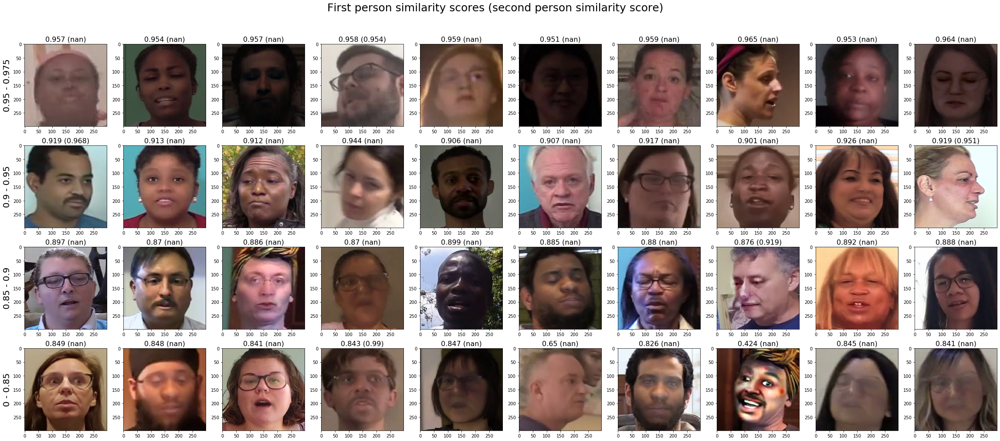

In [95]:
f, ax = plt.subplots(len(similarity_ranges),n_samples, figsize=(n_samples*plot_img_size,
                                                                len(similarity_ranges)*plot_img_size))

for row,(min_similarity,max_similarity) in enumerate(similarity_ranges):
    # get samples from this range
    df_samples = df_diff[df_diff['min_first_person_similarity'] > min_similarity]
    df_samples = df_samples[df_samples['min_first_person_similarity'] <= max_similarity]
    ax[row,0].set_ylabel('{0} - {1}'.format(min_similarity,max_similarity),fontsize=20)
    for col in range(min(n_samples,len(df_samples))):
        score = df_samples.iloc[col]['min_first_person_similarity']
        second_person_score = df_samples.iloc[col]['min_second_person_similarity']
        video_fn = df_samples.iloc[col]['index']
        score_arr = arrayMean(str2array(df_samples.iloc[col]['first_person_similarities']))
        img = getFaceImg(video_fn, frame_index=np.argmin(score_arr))
        ax[row,col].imshow(img)
        ax[row,col].set_title('{0:.3} ({1:.3})'.format(score, second_person_score),fontsize=16)
f.suptitle('First person similarity scores (second person similarity score)',fontsize=25)
plt.subplots_adjust(top=0.90)

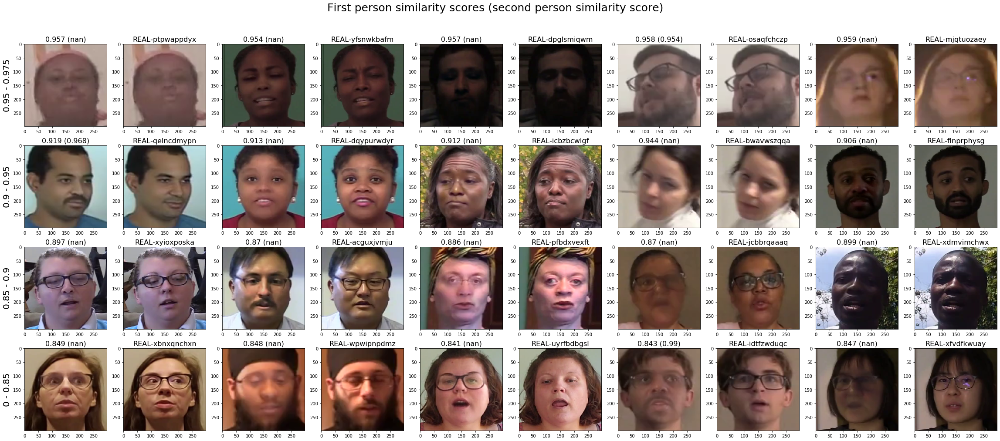

In [97]:
n_samples = 5
f, ax = plt.subplots(len(similarity_ranges),n_samples*2, figsize=(n_samples*2*plot_img_size,
                                                                len(similarity_ranges)*plot_img_size))

for row,(min_similarity,max_similarity) in enumerate(similarity_ranges):
    # get samples from this range
    df_samples = df_diff[df_diff['min_first_person_similarity'] > min_similarity]
    df_samples = df_samples[df_samples['min_first_person_similarity'] <= max_similarity]
    ax[row,0].set_ylabel('{0} - {1}'.format(min_similarity,max_similarity),fontsize=20)
    for col in range(min(n_samples,len(df_samples))):
        score = df_samples.iloc[col]['min_first_person_similarity']
        second_person_score = df_samples.iloc[col]['min_second_person_similarity']
        video_fn = df_samples.iloc[col]['index']
        score_arr = arrayMean(str2array(df_samples.iloc[col]['first_person_similarities']))
        img = getFaceImg(video_fn, frame_index=np.argmin(score_arr))
        ax[row,col*2].imshow(img)
        ax[row,col*2].set_title('{0:.3} ({1:.3})'.format(score, second_person_score),fontsize=16)
        
        real_video = df_samples.iloc[col]['original']
        realImg = getFaceImg(real_video, frame_index=np.argmin(score_arr))
        ax[row,col*2+1].imshow(realImg)
        ax[row,col*2+1].set_title('REAL-' + real_video.replace('.mp4',''), fontsize=16)
f.suptitle('First person similarity scores (second person similarity score)',fontsize=25)
plt.subplots_adjust(top=0.90)

The min similarity doesn't seem to separate different types of fakes all by itself. We could try std.

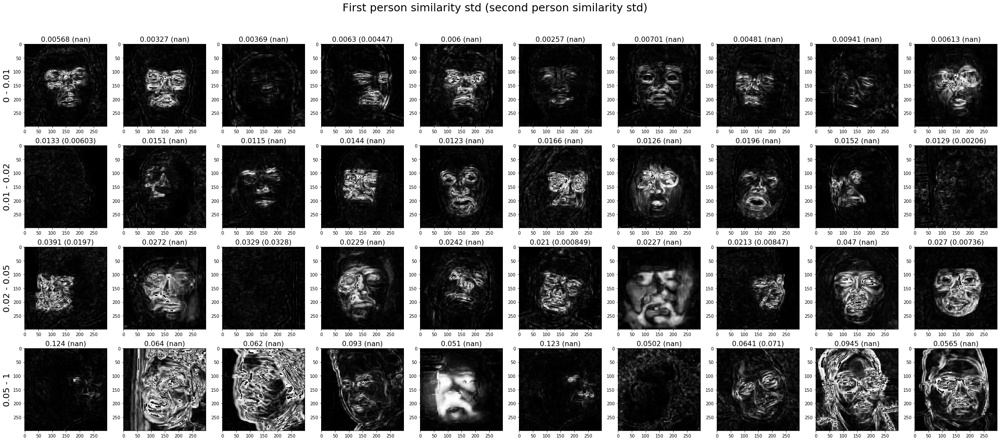

In [98]:
n_samples = 10
TH_1 = 0.01
TH_2 = 0.02
TH_3 = 0.05

similarity_ranges = [[0,TH_1],
                     [TH_1,TH_2],
                     [TH_2,TH_3],
                     [TH_3,1]]

f, ax = plt.subplots(len(similarity_ranges),n_samples, figsize=(n_samples*plot_img_size,
                                                                len(similarity_ranges)*plot_img_size))

for row,(min_similarity,max_similarity) in enumerate(similarity_ranges):
    # get samples from this range
    df_samples = df_diff[df_diff['std_first_person_similarity'] > min_similarity]
    df_samples = df_samples[df_samples['std_first_person_similarity'] <= max_similarity]
    ax[row,0].set_ylabel('{0} - {1}'.format(min_similarity,max_similarity),fontsize=20)
    for col in range(min(n_samples,len(df_samples))):
        score = df_samples.iloc[col]['std_first_person_similarity']
        second_person_score = df_samples.iloc[col]['std_second_person_similarity']
        video_fn = df_samples.iloc[col]['index']
        score_arr = arrayMean(str2array(df_samples.iloc[col]['first_person_similarities']))
        img = getDiffMask(video_fn, frame_index=np.argmin(score_arr))
        ax[row,col].imshow(img)
        ax[row,col].set_title('{0:.3} ({1:.3})'.format(score, second_person_score),fontsize=16)
f.suptitle('First person similarity std (second person similarity std)',fontsize=25)
plt.subplots_adjust(top=0.90)

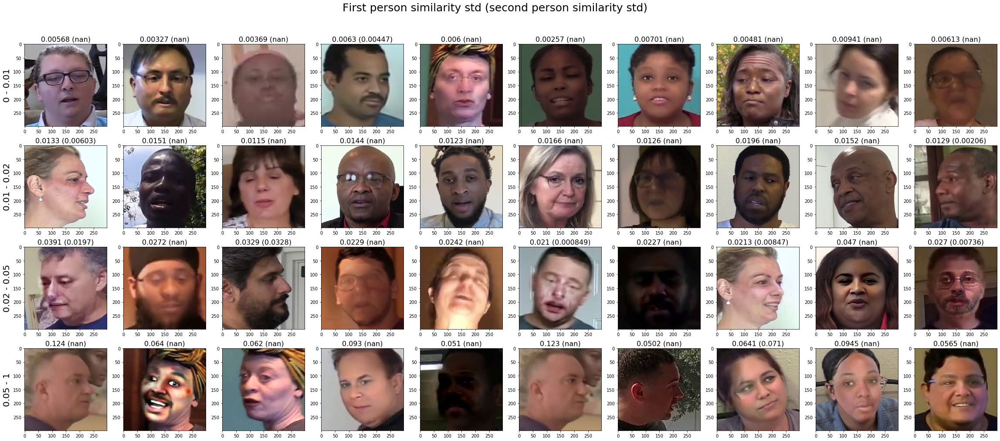

In [99]:
f, ax = plt.subplots(len(similarity_ranges),n_samples, figsize=(n_samples*plot_img_size,
                                                                len(similarity_ranges)*plot_img_size))

for row,(min_similarity,max_similarity) in enumerate(similarity_ranges):
    # get samples from this range
    df_samples = df_diff[df_diff['std_first_person_similarity'] > min_similarity]
    df_samples = df_samples[df_samples['std_first_person_similarity'] <= max_similarity]
    ax[row,0].set_ylabel('{0} - {1}'.format(min_similarity,max_similarity),fontsize=20)
    for col in range(min(n_samples,len(df_samples))):
        score = df_samples.iloc[col]['std_first_person_similarity']
        second_person_score = df_samples.iloc[col]['std_second_person_similarity']
        video_fn = df_samples.iloc[col]['index']
        score_arr = arrayMean(str2array(df_samples.iloc[col]['first_person_similarities']))
        img = getFaceImg(video_fn, frame_index=np.argmin(score_arr))
        ax[row,col].imshow(img)
        ax[row,col].set_title('{0:.3} ({1:.3})'.format(score, second_person_score),fontsize=16)
f.suptitle('First person similarity std (second person similarity std)',fontsize=25)
plt.subplots_adjust(top=0.90)

The min similarity is probably better.

In [100]:
def classifyFrame(similarity):
    if similarity > SIMILARITY_TH:
        return 0
    elif similarity > 0.95:
        return 1
    elif similarity > 0.9:
        return 2
    elif similarity > 0.85:
        return 3
    else:
        return 4

In [118]:
df = pd.read_csv('../data/frame_diff.csv')
df['first_person_label'] = np.nan
df['second_person_label'] = np.nan
df['first_person_frame_labels'] = np.nan
df['second_person_frame_labels'] = np.nan
df['first_person_frame_labels'] = df['first_person_frame_labels'].astype('object')
df['second_person_frame_labels'] = df['second_person_frame_labels'].astype('object')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 119154 entries, 0 to 119153
Data columns (total 8 columns):
index                         119154 non-null object
original                      100000 non-null object
first_person_similarities     118176 non-null object
second_person_similarities    13123 non-null object
first_person_label            0 non-null float64
second_person_label           0 non-null float64
first_person_frame_labels     0 non-null object
second_person_frame_labels    0 non-null object
dtypes: float64(2), object(6)
memory usage: 7.3+ MB


In [119]:
for ind in tqdm(df.index.values):
    firstPersonArr = str2array(df.loc[ind,'first_person_similarities'])
    secondPersonArr = str2array(df.loc[ind,'second_person_similarities'])
    firstClasses = [classifyFrame(val) for val in firstPersonArr] if firstPersonArr is not None else np.nan 
    secondClasses = [classifyFrame(val) for val in secondPersonArr] if secondPersonArr is not None else np.nan
    firstClass = max(firstClasses) if firstClasses is not np.nan else np.nan
    secondClass = max(secondClasses) if secondClasses is not np.nan else np.nan
    df.at[ind,'first_person_label'] = firstClass
    df.at[ind,'second_person_label'] = secondClass
    df.at[ind,'first_person_frame_labels'] = firstClasses
    df.at[ind,'second_person_frame_labels'] = secondClasses

In [120]:
df.head()

,index,original,first_person_similarities,second_person_similarities,first_person_label,second_person_label,first_person_frame_labels,second_person_frame_labels
0,gmuagvvcen.mp4,xyioxposka.mp4,[0.90662205 0.91454544 0.90863778 0.90787758 0...,NaN,3.0,NaN,"[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 2, 2, 2, 2, ...",NaN
1,nlbejgudfx.mp4,acguxjvmju.mp4,[0.87670463 0.87884638 0.88174117 0.88052886 0...,NaN,3.0,NaN,"[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, ...",NaN
2,smptxlklxc.mp4,NaN,[1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. ...,NaN,0.0,NaN,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",NaN
3,xmodyeeaxr.mp4,ptpwappdyx.mp4,[0.96768544 0.9703409 0.96584001 0.96793804 0...,NaN,1.0,NaN,"[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, ...",NaN
4,hvxrsfgvyi.mp4,qelncdmypn.mp4,[0.93245532 0.93241838 0.93094194 0.93391931 0...,[0.96927007 0.9687523 0.97080696 0.96831491 0...,2.0,1.0,"[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, ...","[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, ..."


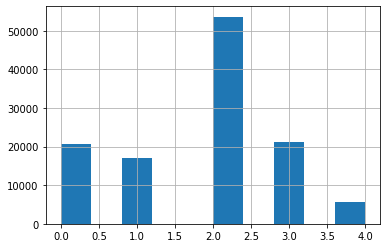

In [121]:
df.first_person_label.hist()

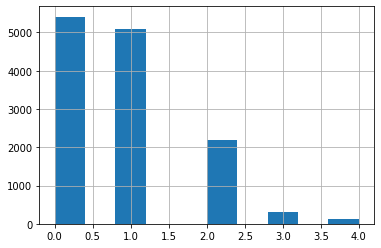

In [122]:
df.second_person_label.hist()

In [123]:
df.to_csv('../data/fake_type_classes.csv',index=False)